# PDE Learning with Diffusion Models
by Jackson Harmon and Yoab Rabinovich

Supervisor: Tobias Weber


---



## An Introduction to Diffusion Models

**Limitations of Deterministic Mappings**

- Most ML-based PDE methods learn deterministic mappings between states:
$$\mathcal{F}:\mathcal{A} \rightarrow \mathcal{U}, \ \ \ \mathcal{I}:\mathcal{U} \rightarrow \mathcal{A}$$
- Like numerical solvers, they typically rely on complete observations and fail in sparse observation cases (like real-world data).

**Generative Models**

- We can learn the joint distribution of the entire coefficient-solution space.

- With a generative prior over the space, we can sample the coefficient field and solution simultaneously.

Rather than model $p(x_t | x_0)$, we model $p(x_t, x_0)$.

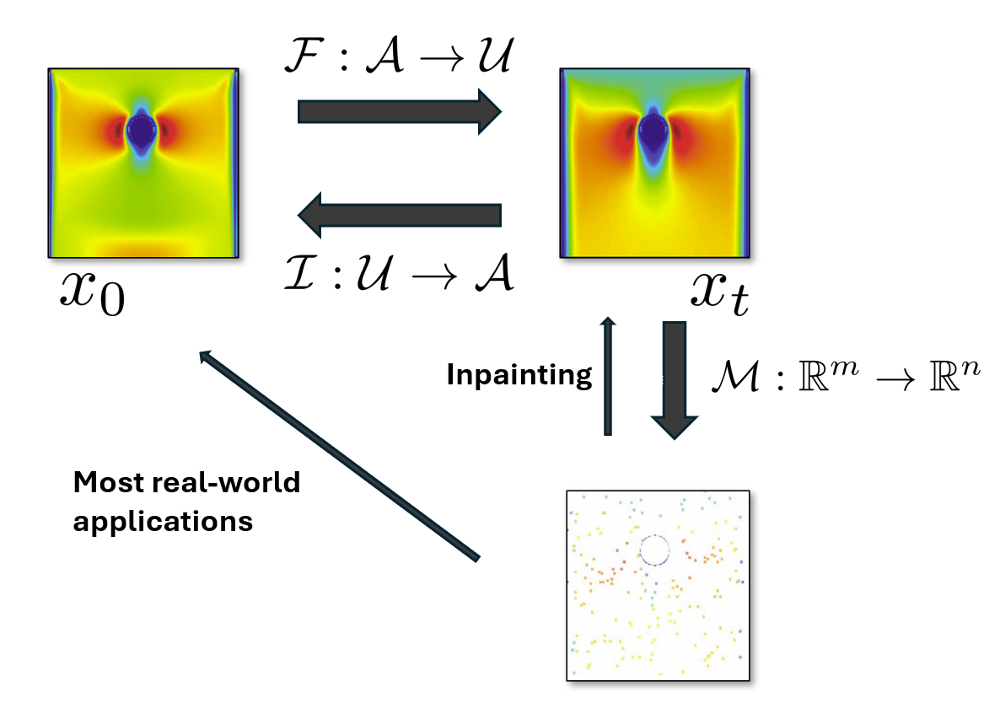

In [ ]:
#@title Imports

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec
from IPython.display import HTML

import scipy
from scipy.stats import multivariate_normal
import scipy.io as sio

import math
from math import sqrt

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, transforms
from diffusers import UNet2DModel

from tqdm import tqdm

import pickle
import yaml

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Device: {device}")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

Retrieving folder contents
Processing file 1h2ZColdDpEJ2DUIuUWxEdfpTCbrUrLVw poisson_circle_results.mat
Processing file 1_18HldvjOvZOsphp-LG9Ul8fxPHW2r3A poisson_results.mat
Processing file 1kBYCq3HxjOBfcr-rZm95bpL5EKeg4I2d poisson_sample.mat
Retrieving folder contents completed
Building directory structure
Building directory structure completed
Downloading...
From (original): https://drive.google.com/uc?id=1h2ZColdDpEJ2DUIuUWxEdfpTCbrUrLVw
From (redirected): https://drive.google.com/uc?id=1h2ZColdDpEJ2DUIuUWxEdfpTCbrUrLVw&confirm=t&uuid=2376418f-c598-4f19-a4ec-2c250cccfe8a
To: /content/DiffusionPDE_data/poisson_circle_results.mat
100% 394k/394k [00:00<00:00, 119MB/s]
Downloading...
From (original): https://drive.google.com/uc?id=1_18HldvjOvZOsphp-LG9Ul8fxPHW2r3A
From (redirected): https://drive.google.com/uc?id=1_18HldvjOvZOsphp-LG9Ul8fxPHW2r3A&confirm=t&uuid=06f13c6e-897c-41f4-96df-7a758aee7ebc
To: /content/DiffusionPDE_data/poisson_results.mat
100% 394k/394k [00:00<00:00, 78.5MB/s]


In [ ]:
# Download experiment data if required
# !pip install -q gdown
# !gdown --folder "https://drive.google.com/drive/folders/1u0vNz6M6uWvsuNORVB-_YAw50TOuRzrY"

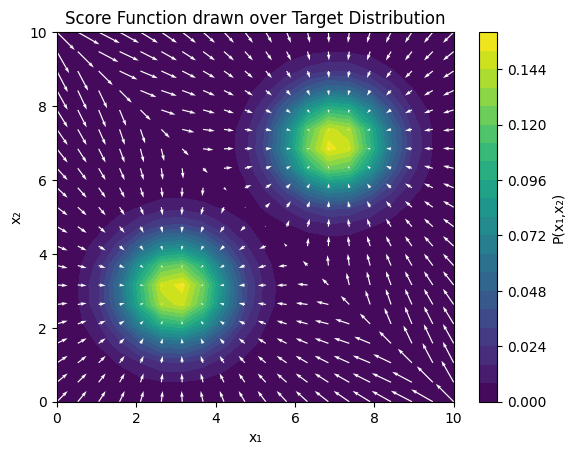

In [ ]:
#@title Toy Example: Bimodal Joint Distribution in 2D
# Distribution Parameters
x_lims = [0,10]
y_lims = [0,10]
mu1, mu2 = 3, 7
sigma = 1

def score_function_2d_gaussian(x, y, mu1, mu2, sigma):
    """
    Computes the score function for a bimodal Gaussian joint distribution.
    """
    coords = np.dstack((x, y))
    cov = [[sigma, 0], [0, sigma]]
    pdf1 = multivariate_normal.pdf((coords), mean=[mu1, mu1], cov=cov)
    pdf2 = multivariate_normal.pdf((coords), mean=[mu2, mu2], cov=cov)
    pdf = pdf1 + pdf2

    grad_x = (pdf1 * (x - mu1) / sigma**2 + pdf2 * (x - mu2) / sigma**2) / pdf
    grad_y = (pdf1 * (y - mu1) / sigma**2 + pdf2 * (y - mu2) / sigma**2) / pdf

    return -grad_x, -grad_y, pdf

def score_field(ax=None,
                x_lims=x_lims, y_lims=y_lims,
                mu1=mu1, mu2=mu2,
                sigma=sigma,
                grid_size=20,
                colorbar = True,
                show=True):
    """
    Draws the score function background on the given axis.
    """
    # Create a new figure and axis if not provided.
    if ax is None:
        fig, ax = plt.subplots()
    else:
        fig = ax.figure

    # Generate 2D Grid
    x = np.linspace(x_lims[0], x_lims[1], grid_size)
    y = np.linspace(y_lims[0], y_lims[1], grid_size)
    X, Y = np.meshgrid(x, y)

    # Compute gradients and probability density
    U, V, pdf = score_function_2d_gaussian(X, Y, mu1, mu2, sigma)

    # Plot the contour and vector field
    contour = ax.contourf(X, Y, pdf, levels=20, cmap='viridis')
    ax.quiver(X, Y, U, V, color='white')
    ax.set_title('Score Function drawn over Target Distribution')
    ax.set_xlabel('x₁')
    ax.set_ylabel('x₂')
    if colorbar:
      fig.colorbar(contour, ax=ax, label="P(x₁,x₂)")

    if show:
        plt.show()
    else:
        plt.close()

    return fig, ax, pdf

_, _, pdf = score_field()

**Score Matching**

- Modeling a distribution:
$$p(x) = \frac{e^{-f_{\theta}(x)}}{Z} $$
- Dealing with the partition function:
$\require{cancel}$
$$\nabla_x \log p(x) = - \nabla_x f_{\theta}(x) - \cancel{\nabla_x \log {Z}}$$
- Score function:
$$s_{\theta}(x) = - \nabla_x f_{\theta}(x)$$
- Fisher Divergence Loss:
$$\min_{\theta} \frac{1}{2}\mathbb{E}_{p(x)}[\|s_{\theta}(x) - \nabla_x \log p(x)\|_2^2]$$

**Annealing**

- Often, no signal in most of the space. So we spread out the signal:
$$\tilde{x} = x + \epsilon \sim \mathcal{N}(0, \sigma^2)$$

- Train conditioned model:
$$s_{\theta}(\tilde{x}, \sigma)$$

- Learning the score function is equivalent to learning a denoising function.
$$\min_{\theta} \frac{1}{2}\mathbb{E}_{p(x),p_\sigma(\tilde{x}|x)}[\|s_{\theta}(\tilde{x},\sigma) - \frac{1}{\sigma^2}\epsilon\|_2^2]$$

In [ ]:
# Parameters
x_lims = [0,10]
y_lims = [0,10]
mu1, mu2 = 3, 7
sigma_values = np.linspace(6, 0.5, 30) # Noise schedule

# Generate figure
fig, ax, _ = score_field(show=False)

# Draw each frame
def update(frame):
    current_sigma = sigma_values[frame]
    ax.clear()
    score_field(ax=ax, sigma=current_sigma, colorbar=False, show=False)
    return ax.get_children()

ani = FuncAnimation(fig, update, frames=len(sigma_values), interval=100, blit=False)
HTML(ani.to_jshtml())

**Diffusion Models**

$s(x,\sigma)$ allows us to sample from an envelope distribution, and iteratively denoise into a sample from $p(x)$.
1. Train a denoiser $s(x,\sigma)$.
2. Sample $x_t$ from the normal distribution.
3. Iteratively denoise $x_t$ while annealing $\sigma$.
4. At final iteration, approximately $x_0 \sim p(x)$.

In [ ]:
class DiffusionModel:
    def __init__(self, timesteps=250, device: str = 'cuda'):
        self.timesteps = timesteps
        self.device = device

        # Noise Schedule
        self.sigma_min = 0.002
        self.sigma_max = 80
        self.sigma = self.sigma_min * (self.sigma_max / self.sigma_min) ** (torch.linspace(0, 1, timesteps).to(self.device))

    def q_sample(self, x_0, t):
        """
        Sample noise and return the noised input.
        """
        noise = torch.randn_like(x_0).to(self.device)
        sigma_t = self.sigma[t.to(self.device)].reshape(-1, 1, 1, 1)
        return x_0 + sigma_t * noise, noise

    def train(self, model, dataloader, epochs=10, device='cuda'):
        optimizer = torch.optim.AdamW(model.parameters(), lr=2e-4, weight_decay=1e-4)
        for epoch in range(epochs):
            total_loss = 0
            dataloader_enumerator = enumerate(dataloader)
            dataloader_enumerator = tqdm(dataloader_enumerator)
            for batch_idx, (data, _) in dataloader_enumerator:
                data = data.to(device)
                optimizer.zero_grad()

                # Sample noise corresponding to random timestep
                t = torch.randint(0, self.timesteps, (data.shape[0],), device=device)
                x_t, noise = self.q_sample(data, t)
                # Predict noise
                noise_pred = model(x_t, t).sample
                # Weighted MSE loss
                weight = 1.0 / (self.sigma[t] ** 2 + 1.0).view(-1, 1, 1, 1)
                loss = (F.mse_loss(noise_pred, noise, reduction='none') * weight).mean()

                loss.backward()
                optimizer.step()

                total_loss += loss.item()

            print(f"Epoch {epoch+1}/{epochs}, Loss: {total_loss/len(dataloader):.4f}")

In [ ]:
#@title Noise Prediction Model
model = UNet2DModel(
    in_channels=1,                        # Grayscale input
    out_channels=1,                       # Grayscale output
    layers_per_block=2,                   # Depth of each UNet block
    block_out_channels=(128, 256, 256),   # Encoder/decoder channels
    down_block_types=("DownBlock2D",      # Downsampling blocks
                      "DownBlock2D",
                      "AttnDownBlock2D"),
    up_block_types=("AttnUpBlock2D",      # Upsampling blocks
                    "UpBlock2D",
                    "UpBlock2D"),
).to(device)

In [ ]:
#@title Dataset code
# Dataset parameters
num_samples = 1000
track_size = (2, 20)
block_size = (2, 2)
batch_size = 32

class RaceTrackDataset(Dataset):
    def __init__(self, num_samples=num_samples, track_size=track_size, block_size=block_size, joint_distribution=None):
        """
        Dataset of (n,n) blocks on (n,m) tracks, in states T=0 and T=t.
        Initial position and velocity sampled on the fly from joint PDF.
        """
        self.num_samples = num_samples
        self.track_size = track_size
        self.block_size = block_size

        # Normalize the joint distribution to form a probability matrix
        if joint_distribution is not None:
            self.joint_distribution = joint_distribution / joint_distribution.sum()
            self.start_positions = np.arange(joint_distribution.shape[0])
            self.velocities = np.arange(joint_distribution.shape[1])
        else:
            raise ValueError("Joint distribution must be provided.")

    def __len__(self):
        return self.num_samples

    def sample_from_distribution(self):
        """ Sample (start_x, velocity) from the given joint distribution. """
        flat_index = np.random.choice(self.joint_distribution.size, p=self.joint_distribution.ravel())
        start_idx, vel_idx = np.unravel_index(flat_index, self.joint_distribution.shape)
        start_x = self.start_positions[start_idx]
        velocity = self.velocities[vel_idx]
        return start_x, velocity

    def __getitem__(self, idx):
        # Sample start position and velocity
        start_x, velocity = self.sample_from_distribution()

        # Create empty tracks
        track_initial = np.zeros(self.track_size, dtype=np.float32)
        track_final = np.zeros(self.track_size, dtype=np.float32)

        # Place the block at the initial position
        track_initial[:, start_x:start_x + self.block_size[1]] = 1.0

        # Compute final position with circular boundary conditions
        end_x = (start_x + velocity) % self.track_size[1]
        track_final[:, end_x:end_x + self.block_size[1]] = 1.0

        # Concatenate initial and final state into one tensor (20x100)
        combined_track = np.vstack((track_initial, track_final))

        # Convert to tensor and reshape
        data = torch.tensor(combined_track, dtype=torch.float32).unsqueeze(0)

        # Pair with labels
        label = torch.tensor([start_x, velocity], dtype=torch.float32)

        return data, label

**Toy Dataset**
- We demonstrate with a toy PDE dataset, depicting objects moving right.
$$f(x_0,x_t,v) = x_t-x_0-v$$
- Each example is made up of $s_0$ and $s_t$.
- $x_0$ and $v$ sampled from a joint PDF.

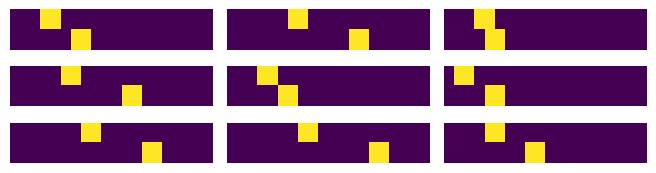

In [ ]:
def visualize_samples(samples, n_visualize=9):
  """
  Visualize samples in a grid.
  """
  plt.figure(figsize=(track_size[1]/sqrt(n_visualize), track_size[0]))
  for i in range(n_visualize):
      n_subplots = int(sqrt(n_visualize))
      plt.subplot(n_subplots, n_subplots, i+1)
      plt.imshow(samples[i][0])
      plt.axis('off')

  plt.tight_layout()
  plt.show()

# Create DataLoader using the joint distribution
param_range = 10
_, _, pdf = score_field(grid_size=param_range, show=False);
dataset = RaceTrackDataset(num_samples=20_000, joint_distribution=pdf)
dataloader = DataLoader(dataset, batch_size=256, shuffle=True)

# Visualize Dataset
n_visualize = 9
batch = next(iter(dataloader))
visualize_samples(batch[0],n_visualize)

In [ ]:
# Train Diffusion Model
diffusion = DiffusionModel(timesteps=100, device=device)
diffusion.train(model, dataloader, epochs=7, device=device) # 7 epochs (~2m 20s)

79it [00:21,  3.68it/s]


Epoch 1/7, Loss: 0.2720


79it [00:21,  3.73it/s]


Epoch 2/7, Loss: 0.1022


79it [00:21,  3.75it/s]


Epoch 3/7, Loss: 0.0730


79it [00:21,  3.74it/s]


Epoch 4/7, Loss: 0.0596


79it [00:21,  3.67it/s]


Epoch 5/7, Loss: 0.0484


79it [00:21,  3.74it/s]


Epoch 6/7, Loss: 0.0421


79it [00:21,  3.74it/s]

Epoch 7/7, Loss: 0.0409


- The trained model should be able to reproduce samples from the joint $p(x_0, v)$.
- Diffusion models have different formulations and implementations (DDPM, DDIM, DPM...)
- We use Denoising Score Matching with Langevin Dynamics (SMLD).
- Langevin dynamics ensure samples conform to $p(x)$ and don't collapse to point $\max p(x)$.
$$\tilde{x}_{i+1} \leftarrow \tilde{x}_i +\alpha s_\theta(\tilde{x}_i)+\sqrt{2\alpha} \epsilon$$
- This isn't pertinent in our toy example, dropped for simplicity.

In [ ]:
def p_sample(diffusion, model, x_t, t, device):
    """
    Denoise the input using the trained model.
    """
    with torch.no_grad():
        t_tensor  = torch.full((x_t.size(0),), t, device=device)
        sigma_t   = diffusion.sigma[t_tensor][:, None, None, None]
        sigma_tm1 = diffusion.sigma[t_tensor-1][:, None, None, None]
        # Predict noise and subtract it
        noise_pred = model(x_t, t_tensor).sample
        out = x_t - (sigma_t * noise_pred)
        return out

def generate_samples(model, diffusion, n_samples=16, device=device):
    """
    Generate samples from the trained model.
    """
    model.eval()
    t_total = diffusion.timesteps
    # Sample random noise
    x = torch.randn(n_samples, 1, track_size[0]*2, track_size[1]).to(device)
    diffusion_steps = np.zeros((t_total, n_samples, 1, track_size[0]*2, track_size[1]))

    for t in reversed(range(t_total)):
        # Denoising step
        x = p_sample(diffusion, model, x, t, device)
        diffusion_steps[t] = x.cpu().numpy()
    return diffusion_steps

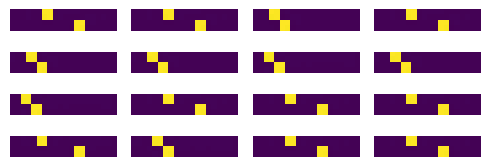

In [ ]:
# Generate samples and plot on grid
n_samples = 16
samples = generate_samples(model, diffusion, n_samples=n_samples)
visualize_samples(samples[1], n_samples)

In [ ]:
# Estimate x_0 and velocity of noisy samples to plot trajectory
def estimate_vars(image):
  x = np.arange(image.shape[1])
  image = (image - image.min()) / (image.max() - image.min())
  s_0 = image[:track_size[0]]
  s_1 = image[track_size[0]:]
  est_x_0 = np.average(x, weights=s_0.sum(axis=0))
  est_x_1 = np.average(x, weights=s_1.sum(axis=0))

  est_v = np.abs(est_x_1-est_x_0) # Circular boundary conditions
  return est_x_0, est_v

In [ ]:
#@title Visualization code
def animate_diffusion_process(samples, x_lims, y_lims, mu1, mu2, sigma_schedule,
                              num_prev_steps=3, step=5, grid_size=20,
                              interval=200, repeat=False, figsize=(12, 6)):
    """
    Animate a diffusion process with a dynamic background (score field),
    trajectories (with moving labels), and an image grid.

    Parameters:
      samples         : numpy array of shape (T, N, 1, H, W) where
                        T = diffusion timesteps, N = number of trajectories.
      x_lims, y_lims  : Tuple (min, max) for the phase-space plot axes.
      mu1, mu2        : Parameters for the score function.
      sigma_schedule  : Array of sigma values (length should be >= number of frames).
      num_prev_steps  : Number of previous trajectory points to display (including current).
      step            : Stride to sample frames from the diffusion process.
      grid_size       : Resolution (number of grid points) for the score field.
      interval        : Milliseconds between frames in the animation.
      figsize         : Size of the overall figure.

    Returns:
      ani  : The FuncAnimation object.
      fig  : The matplotlib figure.
    """

    # Compute frame indices and the number of trajectories.
    frame_indices = np.arange(samples.shape[0] - 1, 0, -step)
    num_frames = len(frame_indices)
    trajectory_count = samples.shape[1]

    # Create the overall figure with two panels.
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(1, 2, width_ratios=[2, 3])

    # -------------------------
    # Left Panel: Phase-space Plot
    # -------------------------
    ax_phase = fig.add_subplot(gs[0, 0])
    ax_phase.set_xlim(x_lims[0], x_lims[1])
    ax_phase.set_ylim(y_lims[0], y_lims[1])
    ax_phase.set_aspect('equal', adjustable='box')
    # This container will hold the background artists (contour, quiver) so we can remove them on update.
    bg_artists = []

    # -------------------------
    # Right Panel: Grid of Denoised Images
    # -------------------------
    # For images that are 10 times wider than tall, we choose more rows and fewer columns.
    ncols = int(np.ceil(np.sqrt(trajectory_count / 10)))
    nrows = int(np.ceil(trajectory_count / ncols))
    gs_right = GridSpecFromSubplotSpec(nrows, ncols, subplot_spec=gs[0, 1],
                                       wspace=0.1, hspace=0.1)
    image_axes = []
    image_artists = []
    image_label_artists = []
    image_labels = [str(i + 1) for i in range(trajectory_count)]
    for i in range(trajectory_count):
        ax_img = fig.add_subplot(gs_right[i // ncols, i % ncols])
        ax_img.axis('off')
        # Initialize with the first frame.
        img0 = samples[frame_indices[0], i, 0]
        im_artist = ax_img.imshow(img0, cmap='viridis', vmin=0, vmax=1)
        image_axes.append(ax_img)
        image_artists.append(im_artist)
        lbl = ax_img.text(0.05, 0.95, image_labels[i],
                          transform=ax_img.transAxes, fontsize=10,
                          color='black', fontweight='bold',
                          verticalalignment='top',
                          bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
        image_label_artists.append(lbl)

    # -------------------------
    # Prepare Trajectory Plotting on ax_phase
    # -------------------------
    traj_coords = [[] for _ in range(trajectory_count)]
    lines = []        # Lines showing the tail of each trajectory.
    arrow_artists = [[] for _ in range(trajectory_count)]  # For arrow segments.
    for traj in range(trajectory_count):
        line, = ax_phase.plot([], [], 'ro-', markersize=4, alpha=0.5)
        lines.append(line)
    # Create moving labels (displayed only at the current coordinate).
    label_artists = []
    for traj in range(trajectory_count):
        # Get initial coordinate from the first frame.
        init_img = samples[frame_indices[0], traj, 0]
        initial_coord = estimate_vars(init_img)
        t = ax_phase.text(initial_coord[0], initial_coord[1], image_labels[traj],
                          fontsize=10, color='black', fontweight='bold',
                          bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
        label_artists.append(t)

    # -------------------------
    # Inner Function: Draw Score Field Background
    # -------------------------
    def draw_score_field(ax, sigma, add_colorbar=True):
        # Generate a 2D grid.
        x = np.linspace(x_lims[0], x_lims[1], grid_size)
        y = np.linspace(y_lims[0], y_lims[1], grid_size)
        X, Y = np.meshgrid(x, y)
        # Compute gradients and probability density.
        U, V, pdf = score_function_2d_gaussian(X, Y, mu1, mu2, sigma)
        contour = ax.contourf(X, Y, pdf, levels=20, cmap='viridis')
        quiver = ax.quiver(X, Y, U, V, color='white')
        ax.set_title('Score Function drawn over Target Distribution')
        ax.set_xlabel('x_1')
        ax.set_ylabel('x_2')
        if add_colorbar:
            fig.colorbar(contour, ax=ax, label="P(x_1,x_2)")
        return [contour, quiver]

    # -------------------------
    # Update Function for Animation
    # -------------------------
    def update(frame):
        nonlocal bg_artists, ax_phase
        idx = frame_indices[frame]

        # Update the background: remove previous background artists.
        for artist in bg_artists:
            try:
                artist.remove()
            except Exception:
                pass
        bg_artists = []
        # Get the current sigma from the sigma_schedule.
        current_sigma = sigma_schedule[idx]
        new_bg_artists = draw_score_field(ax_phase, sigma=current_sigma, add_colorbar=False)
        bg_artists = new_bg_artists

        updated_artists = []
        # Update trajectories and image grid.
        for traj in range(trajectory_count):
            # Update the image for this trajectory.
            image = samples[idx, traj, 0]
            image_artists[traj].set_data(image)
            # Compute the 2D coordinate from the image (using your estimation function).
            coord = estimate_vars(image)
            traj_coords[traj].append(coord)
            coords_arr = np.array(traj_coords[traj])
            if coords_arr.shape[0] > num_prev_steps:
                pts_to_draw = coords_arr[-num_prev_steps:]
            else:
                pts_to_draw = coords_arr
            # Update the tail line.
            lines[traj].set_data(pts_to_draw[:, 0], pts_to_draw[:, 1])
            updated_artists.append(lines[traj])
            # Remove any previous arrow segments.
            for arrow in arrow_artists[traj]:
                try:
                    arrow.remove()
                except Exception:
                    pass
            arrow_artists[traj] = []
            # Draw arrows for consecutive segments in the tail.
            if pts_to_draw.shape[0] >= 2:
                for i in range(pts_to_draw.shape[0] - 1):
                    x0, y0 = pts_to_draw[i]
                    dx = pts_to_draw[i + 1, 0] - pts_to_draw[i, 0]
                    dy = pts_to_draw[i + 1, 1] - pts_to_draw[i, 1]
                    arrow = ax_phase.arrow(x0, y0, dx, dy, color='red', alpha=0.2,
                                           head_width=0.01 * (x_lims[1] - x_lims[0]),
                                           head_length=0.01 * (y_lims[1] - y_lims[0]))
                    arrow_artists[traj].append(arrow)
                    updated_artists.append(arrow)
            # Update the moving label (displayed only at the current coordinate).
            offset = 0.02 * (x_lims[1] - x_lims[0])
            label_artists[traj].set_position((coord[0] + offset, coord[1] + offset))
            updated_artists.append(label_artists[traj])
            updated_artists.append(image_artists[traj])
        updated_artists.extend(bg_artists)
        return updated_artists

    # -------------------------
    # Create the Animation
    # -------------------------
    ani = FuncAnimation(fig, update, frames=num_frames, interval=interval, repeat=repeat, blit=False)
    plt.suptitle("Diffusion Process: Dynamic Background, Trajectory History, and Moving Labels")
    return ani, fig

In [ ]:
# Visualize Trajectories
sigma_schedule = np.linspace(0.5, 9.5, 100)
ani, fig = animate_diffusion_process(samples, x_lims, y_lims, mu1, mu2, sigma_schedule,
                                      num_prev_steps=3, step=5, grid_size=20,
                                      interval=200, figsize=(12, 6))

plt.close()
HTML(ani.to_jshtml())

**Guided Diffusion**
- We can sample from $p(x)$.
- How to sample according to partial observations?
- Instead of modeling the prior $p(x_t, x_0)$, model a posterior $p(x_t, x_0 | y)$.
- Bayes' Rule
$\require{cancel}$
$$\nabla_x \log p(x | y) = \nabla_x \log p(x) + \nabla_x \log p(y | x) - \cancel{\nabla_x \log p(y)}$$

In [ ]:
class BinaryClassifier(nn.Module):
    """
    CNN with binary velocity labels.
    """
    def __init__(self, diffusion):
        super(BinaryClassifier, self).__init__()
        self.conv_layers = nn.Sequential(
            nn.Conv2d(1, 16, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(16, 32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2)
        )

        self.fc_layers = nn.Sequential(
            nn.Flatten(),
            nn.Linear(32 * 1 * 5, 64),
            nn.ReLU(),
            nn.Linear(64, 1)
        )
        self.criterion = nn.BCEWithLogitsLoss()
        self.diffusion = diffusion

    def forward(self, x):
        x = self.conv_layers(x)
        x = self.fc_layers(x)
        return x

    def train_model(self, dataloader, epochs=20, lr=0.01):
        optimizer = torch.optim.AdamW(self.parameters(), lr=lr)
        scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr=lr, steps_per_epoch=len(dataloader), epochs=epochs)

        self.train()
        for epoch in range(epochs):
            total_loss = 0
            for images, labels in tqdm(dataloader):
                # Simplify labels to binary choice of velocity around v = 5
                images, labels = images.to(device), labels[:, 1].to(device)  # Discard first coordinate
                labels = (labels > 5).float().unsqueeze(1)  # Convert to binary and reshape to (B,1)

                optimizer.zero_grad()

                t = torch.randint(0, diffusion.timesteps, (images.shape[0],), device=device)
                images, _ = self.diffusion.q_sample(images, t)

                outputs = self(images)
                loss = self.criterion(outputs, labels)
                loss.backward()
                optimizer.step()
                scheduler.step()

                total_loss += loss.item()

            print(f"Epoch {epoch+1}/{epochs}, Loss: {total_loss/len(dataloader):.4f}")


- We can turn a pretrained diffusion model into a guided diffusion model without retraining.
- All we need is a classifier (and we can even do without one).

In [ ]:
classifier = BinaryClassifier(diffusion).to(device)
classifier.train_model(dataloader) # 20 epochs (~40s)

100%|██████████| 79/79 [00:02<00:00, 37.87it/s]


Epoch 1/20, Loss: 0.7057


100%|██████████| 79/79 [00:02<00:00, 32.92it/s]


Epoch 2/20, Loss: 0.5744


100%|██████████| 79/79 [00:01<00:00, 43.17it/s]


Epoch 3/20, Loss: 0.3775


100%|██████████| 79/79 [00:01<00:00, 44.74it/s]


Epoch 4/20, Loss: 0.3351


100%|██████████| 79/79 [00:01<00:00, 44.43it/s]


Epoch 5/20, Loss: 0.3109


100%|██████████| 79/79 [00:01<00:00, 44.90it/s]


Epoch 6/20, Loss: 0.3002


100%|██████████| 79/79 [00:01<00:00, 44.83it/s]


Epoch 7/20, Loss: 0.2994


100%|██████████| 79/79 [00:02<00:00, 33.97it/s]


Epoch 8/20, Loss: 0.2876


100%|██████████| 79/79 [00:01<00:00, 39.65it/s]


Epoch 9/20, Loss: 0.2866


100%|██████████| 79/79 [00:01<00:00, 44.42it/s]


Epoch 10/20, Loss: 0.2825


100%|██████████| 79/79 [00:02<00:00, 36.22it/s]


Epoch 11/20, Loss: 0.2839


100%|██████████| 79/79 [00:01<00:00, 44.09it/s]


Epoch 12/20, Loss: 0.2862


100%|██████████| 79/79 [00:01<00:00, 43.07it/s]


Epoch 13/20, Loss: 0.2799


100%|██████████| 79/79 [00:02<00:00, 35.89it/s]


Epoch 14/20, Loss: 0.2700


100%|██████████| 79/79 [00:02<00:00, 36.81it/s]


Epoch 15/20, Loss: 0.2746


100%|██████████| 79/79 [00:03<00:00, 21.70it/s]


Epoch 16/20, Loss: 0.2778


100%|██████████| 79/79 [00:04<00:00, 16.72it/s]


Epoch 17/20, Loss: 0.2804


100%|██████████| 79/79 [00:04<00:00, 19.05it/s]


Epoch 18/20, Loss: 0.2754


100%|██████████| 79/79 [00:01<00:00, 43.50it/s]


Epoch 19/20, Loss: 0.2742


100%|██████████| 79/79 [00:01<00:00, 43.09it/s]

Epoch 20/20, Loss: 0.2750


In [ ]:
def p_sample_guided(diffusion, model, classifier, class_idx, x_t, t, device, guidance_scale=1.0):
    """
    Denoise the input using the trained model, guided by classifier to specified class.
    """
    t_tensor = torch.full((x_t.size(0),), t, device=device)
    sigma_t = diffusion.sigma[t_tensor][:, None, None, None]

    # Predict noise
    with torch.no_grad():
        noise_pred = model(x_t, t_tensor).sample

    classifier.zero_grad()
    x_t.requires_grad_(True)

    # Get classifier class score
    if class_idx == 0:
        log_prob = torch.nn.functional.logsigmoid(-classifier(x_t)).mean()
    elif class_idx == 1:
        log_prob = torch.nn.functional.logsigmoid(classifier(x_t)).mean()
    else:
        raise ValueError(f'Class idx = {class_idx} is not supported')

    log_prob.backward()
    grad = x_t.grad.detach().clone()
    grad = grad / (grad.norm() + 1e-6) # to avoid gradient instability

    x_t.requires_grad_(False)

    # Combine losses
    noise_pred = sigma_t * noise_pred - guidance_scale * sigma_t * grad
    out = x_t - noise_pred
    return out

def generate_samples_guided(model, diffusion, classifier, class_idx, guidance_scale, n_samples=16, device=device):
    """
    Generate samples from the trained model, guided by classifier to specified class.
    """
    model.eval()
    t_total = diffusion.timesteps
    x_t = torch.randn((n_samples, 1, track_size[0]*2, track_size[1]), device=device)
    diffusion_steps = np.zeros((t_total, n_samples, 1, track_size[0]*2, track_size[1]))
    for t in reversed(range(t_total)):
        # Guided Denoising
        x_t = p_sample_guided(diffusion, model, classifier, class_idx, x_t, t, device, guidance_scale)
        diffusion_steps[t] = x_t.cpu().detach().clone().numpy()
    return diffusion_steps

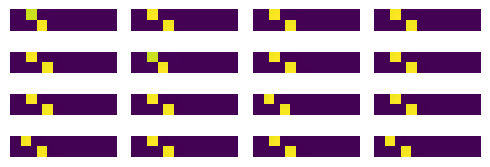

In [ ]:
# Generate samples from specified class
class_idx = 0
guided_samples = generate_samples_guided(model, diffusion, classifier, class_idx, 10)
visualize_samples(guided_samples[0, :], 16)

In [ ]:
# Visualize Trajectories of Classifier Guided Diffusion
ani, fig = animate_diffusion_process(guided_samples, x_lims, y_lims, mu1, mu2, sigma_schedule,
                                      num_prev_steps=3, step=5, grid_size=20,
                                      interval=200, figsize=(12, 6))

plt.close()
HTML(ani.to_jshtml())


## DiffusionPDE
- DiffusionPDE applies two guidance terms, instead of classifier:

- Observation Loss (correction, noisy x):
$$ L_\text{obs} = \frac{1}{n} \| y - \mathcal{M}(x) \|_{2}^{2} $$


- PDE Loss
$$ L_\text{PDE} = \frac{1}{m} \| 0 - f_\text{PDE}{M}(x) \|_{2}^{2} $$

- Combined:
$$ \nabla_x \log p(x | y, f) \approx  \nabla_x \log p(x) - \zeta_\text{obs}\nabla_x \mathcal{L}_\text{obs} - \zeta_\text{PDE} \nabla_x \mathcal{L}_\text{PDE} $$

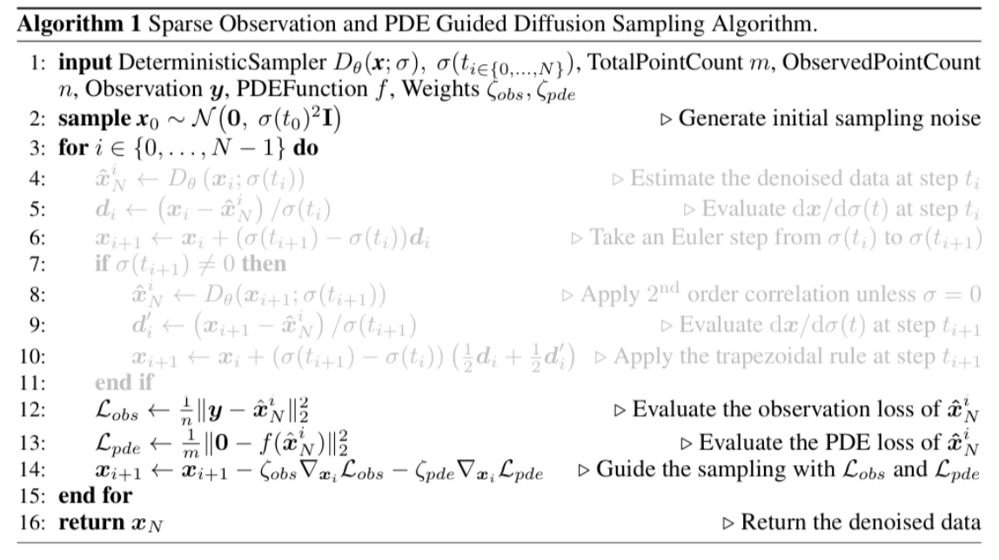


True Observations


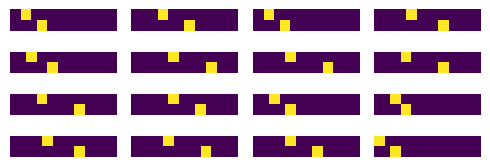

Masked Observations


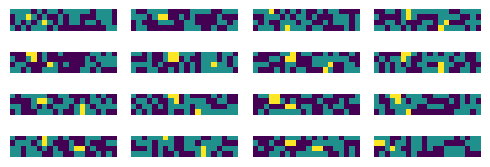

Predicted Observations


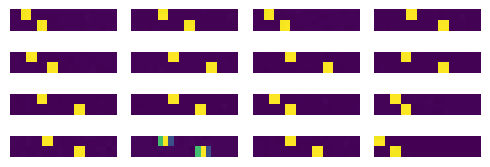

In [ ]:
def observation_loss_fn(data, observations, masks):
    """
    MSE of data and observations.
    """
    return F.mse_loss(torch.masked_select(data, masks),
                      torch.masked_select(observations, masks))

def pde_loss_fn(data, velocities):
    """
    Residual of PDE equation.
    """
    B = data.size(0)
    s_0 = data[:, :, :track_size[0], :]
    s_1 = data[:, :, track_size[0]:, :]
    total_loss = 0.0

    for i in range(B):
        v = int(velocities[i].item())
        # Shift s_0 by v
        shifted = torch.roll(s_0[i:i+1], shifts=v, dims=-1)
        # Compute MSE of s_1 - (s_0+v)
        loss = F.mse_loss(shifted, s_1[i:i+1])
        total_loss += loss
    return total_loss

def p_sample_diffusionPDE(diffusion, model, x_t, observations, masks, velocities, t, device, observation_guidance_scale, pde_guidance_scale):
    """
    Sample from the diffusion model, guided by observations and velocities.
    """
    t_tensor = torch.full((x_t.size(0),), t, device=device)
    sigma_t = diffusion.sigma[t_tensor][:, None, None, None]

    # Predict noise
    with torch.no_grad():
        noise_pred = model(x_t, t_tensor).sample

    model.zero_grad()

    x_t.requires_grad_(True)

    # Compute observation loss and gradient
    observation_loss = observation_loss_fn(x_t, observations, masks)
    scaled_observation = observation_guidance_scale * observation_loss
    scaled_observation.backward()
    grad_observation = x_t.grad.detach().clone()

    # Compute PDE loss and gradient
    if True: # In paper, only at t <= T/5
        pde_loss = pde_loss_fn(x_t, velocities)
        scaled_pde = pde_guidance_scale * pde_loss
        scaled_pde.backward()
        grad_pde = x_t.grad.detach().clone() - grad_observation
    else:
        grad_pde = torch.zeros_like(grad_observation)

    grad = x_t.grad.detach().clone()
    x_t.grad.zero_()
    x_t.requires_grad_(False)

    report = ((sigma_t * noise_pred).norm().item(), grad_observation.norm().item(), grad_pde.norm().item())

    with torch.no_grad():
        out = x_t - sigma_t * noise_pred - grad
    return out, report


def generate_diffusionPDE(diffusion, model, observations, masks, velocities, observation_guidance_scale, pde_guidance_scale, n_samples=batch_size, device=device):
    """
    Generate samples from the diffusion model, guided by observations and velocities.
    """
    t_total = diffusion.timesteps
    x_t = torch.randn((n_samples, 1, track_size[0] * 2, track_size[1]), device=device)
    output_steps = torch.zeros((t_total, n_samples, 1, track_size[0] * 2, track_size[1]))
    reports = np.zeros((t_total, 3))

    for t in reversed(range(t_total)):
        # Guided Denoising
        x_t, report = p_sample_diffusionPDE(diffusion, model, x_t, observations, masks, velocities, t, device, observation_guidance_scale, pde_guidance_scale)
        output_steps[t] = x_t.cpu().detach().clone()
        reports[t] = report

    return output_steps, reports

# Hyper-parameters
observation_guidance_scale = 200
pde_guidance_scale = 3
p_mask = 0.5

# Load Data
observations, labels = next(iter(dataloader))
velocities = labels[:, 1].to(device)

observations = observations[:16].to(device)

observed_masks = (torch.rand_like(observations) > p_mask).to(torch.bool)

# Generate Output
diffusionPDE_samples, reports = generate_diffusionPDE(diffusion, model, observations, observed_masks, velocities, observation_guidance_scale, pde_guidance_scale, n_samples=16, device=device)

# Display
print('True Observations')
visualize_samples(observations.cpu(), 16)

print('Masked Observations')
masked_observations = observations.clone()
masked_observations[~observed_masks] = p_mask
visualize_samples(masked_observations.cpu(), 16)

print('Predicted Observations')
visualize_samples(diffusionPDE_samples.numpy()[0,:,:,:], 16)

# # Plot gradients for debugging
# reports = reports[::-1, :]
# # plot report norms on same axis
# plt.plot(reports[:, 0], label='denoising')
# plt.plot(reports[:, 1], label='observation')
# plt.plot(reports[:, 2], label='pde')
# plt.legend()
# plt.show()

# # plot zooming in at steps (20 to 0) (in reverse)
# plt.plot(reports[80:, 0], label='denoising')
# plt.plot(reports[80:, 1], label='observation')
# plt.plot(reports[80:, 2], label='pde')
# plt.legend()
# plt.show()

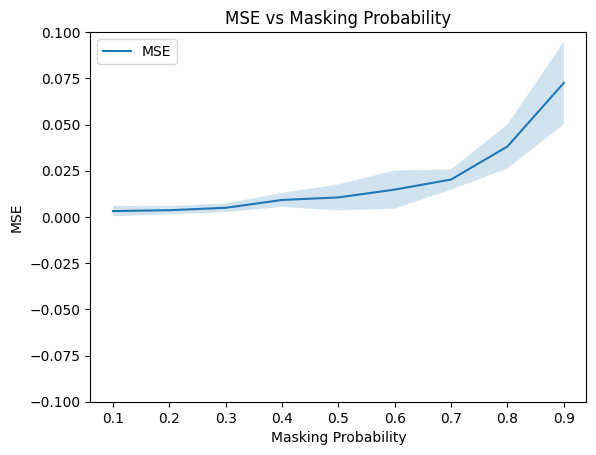

In [ ]:
# Plot MSE and its standard deviation over p_mask (~36 s for n_samples=64)
p_masks = np.linspace(0.1, 0.9, 9)
mse_values = []
mse_std_values = []
n_samples = 64
n_tests = 8

# Compute MSE mean and std for each value of p_mask
for p_mask in p_masks:
    mse_values_for_mask = []
    observations, labels = next(iter(dataloader))
    # subsample to n_samples
    observations = observations[:n_samples]
    labels = labels[:n_samples]
    batch_size = observations.shape[0]
    velocities = labels[:, 1].to(device)
    observations = observations.to(device)
    masks = (torch.rand_like(observations) > p_mask).to(torch.bool)
    output_steps, _ = generate_diffusionPDE(diffusion, model, observations, masks, velocities, observation_guidance_scale, pde_guidance_scale, n_samples=batch_size, device=device)
    for i in range(n_tests):
        test_size = batch_size//n_tests
        mse = F.mse_loss(output_steps[0,i*test_size:(i+1)*test_size], observations.cpu()[i*test_size:(i+1)*test_size])
        mse_values_for_mask.append(mse)
    mse_values.append(np.mean(mse_values_for_mask))
    mse_std_values.append(np.std(mse_values_for_mask))

# Plot
plt.plot(p_masks, mse_values, label='MSE')
plt.fill_between(p_masks, np.array(mse_values) - np.array(mse_std_values), np.array(mse_values) + np.array(mse_std_values), alpha=0.2)
plt.xlabel('Masking Probability')
plt.ylabel('MSE')
plt.title('MSE vs Masking Probability')
plt.legend()
plt.ylim(-0.1,0.1)
plt.show()

In [ ]:
# Visualize trajectories of DiffusionPDE samples
ani, fig = animate_diffusion_process(diffusionPDE_samples.numpy(), x_lims, y_lims, mu1, mu2, sigma_schedule,
                                      num_prev_steps=3, step=5, grid_size=20,
                                      interval=200, figsize=(12, 6))

plt.close()
HTML(ani.to_jshtml())

### DiffusionPDE Results
- Can solve static and dynamic PDEs, forward, inverse and inpainting in any combination of observations.
- The authors claim partial observations amounting to 1-3% of the data can achieve high accuracy.
- Ablation study demonstrate effectiveness of PDE loss.
- 1D experiment applying Diffusion PDE to a complete time evolution of Burger's equaiton.


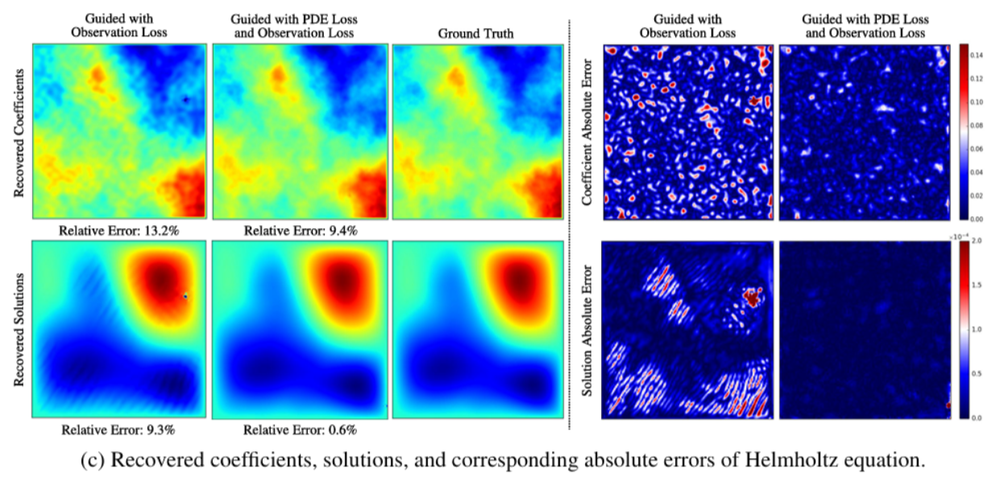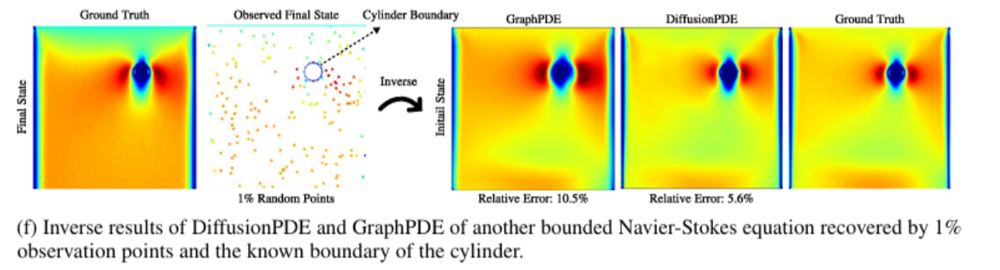

### Testing DiffusionPDE from Paper

- We demonstrate testing the limits of this model, which has been trained on a Poisson PDE.
- Able to handle sparse observations.
- Performance degredation when locally sampling, such as a circular observation range.

**Note**: To run this the "poisson_circle_results.mat", "poisson_results.mat", and "poisson_sample.mat" files must be uploaded to the working directory.

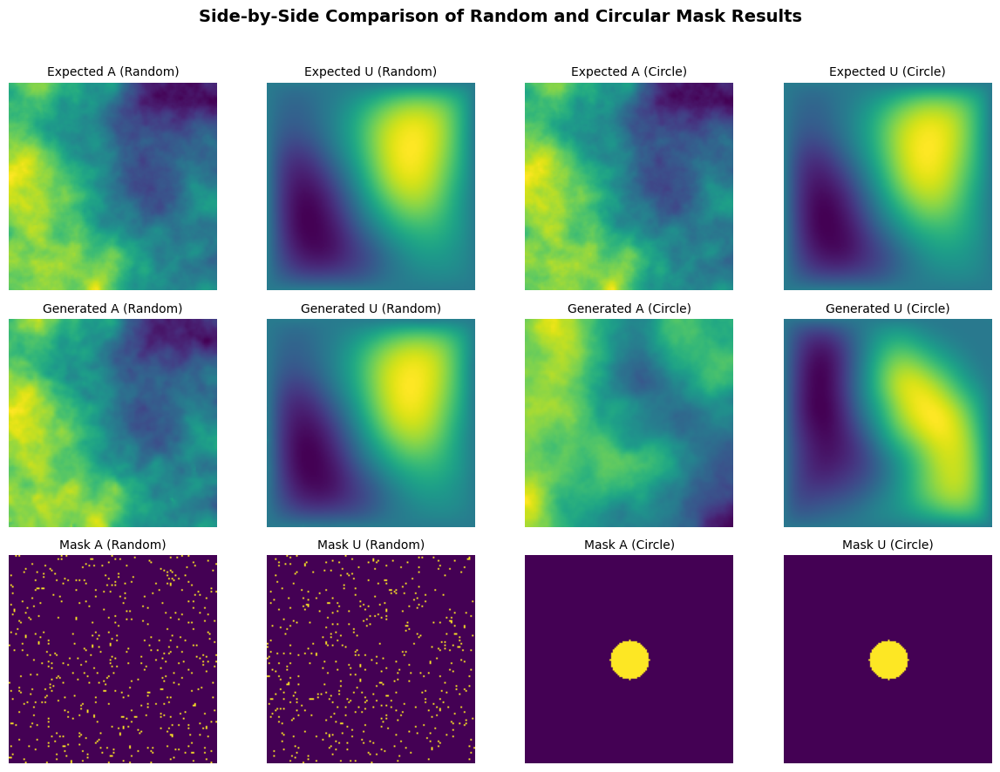

In [ ]:
# Load data
data_path = "DiffusionPDE_data/poisson_sample.mat"
mat_data = sio.loadmat(data_path)

a_data = mat_data['a']
u_data = mat_data['u']

generated_result_random = sio.loadmat("DiffusionPDE_data/poisson_results.mat")
generated_result_circle = sio.loadmat("DiffusionPDE_data/poisson_circle_results.mat")

# Create figure
fig, axs = plt.subplots(3, 4, figsize=(12, 9))
fig.suptitle("Side-by-Side Comparison of Random and Circular Mask Results", fontsize=14, fontweight='bold')

labels = [['Expected A (Random)', 'Expected U (Random)', 'Expected A (Circle)', 'Expected U (Circle)'],
          ['Generated A (Random)', 'Generated U (Random)', 'Generated A (Circle)', 'Generated U (Circle)'],
          ['Mask A (Random)', 'Mask U (Random)', 'Mask A (Circle)', 'Mask U (Circle)']]

data_mappings = [
    [a_data, u_data, a_data, u_data],
    [generated_result_random["a"][0,0], generated_result_random["u"][0,0], generated_result_circle["a"][0,0], generated_result_circle["u"][0,0]],
    [generated_result_random["known_mask_a"], generated_result_random["known_mask_u"], generated_result_circle["known_mask_a"], generated_result_circle["known_mask_u"]]
]

for i in range(3):
    for j in range(4):
        axs[i, j].imshow(data_mappings[i][j], cmap='viridis')
        axs[i, j].set_title(labels[i][j], fontsize=10)
        axs[i, j].axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

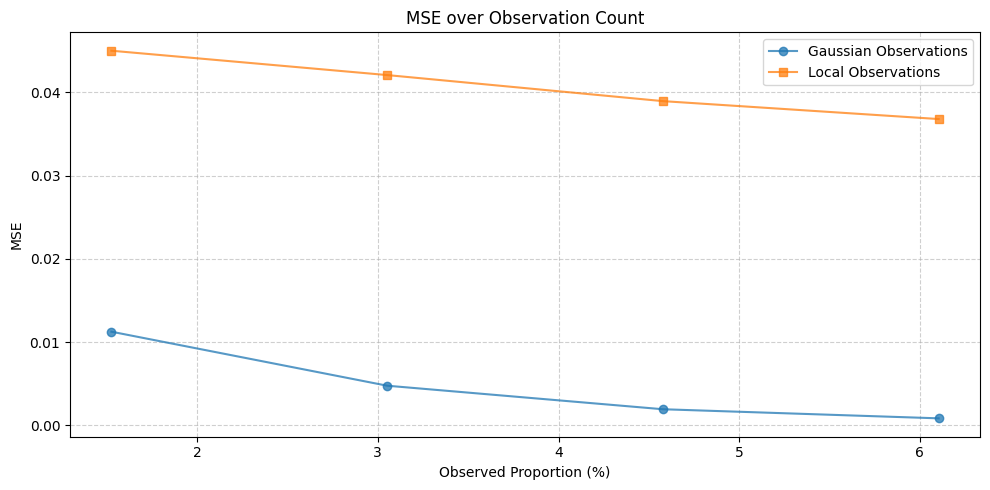

In [ ]:
# Experiment results
x  = np.array([250, 500, 750, 1000])*100/(128*128)
y1 = [0.011240208259638673, 0.004750589660398097, 0.0019229309484385395, 0.0008293450516674718]
y2 = [0.044996165464860405, 0.042070269827080786, 0.038939400144961514, 0.03678706105664513]

# Plot
plt.figure(figsize=(10, 5))

plt.plot(x, y1, marker='o', linestyle='-', label="Gaussian Observations", alpha=0.75)
plt.plot(x, y2, marker='s', linestyle='-', label="Local Observations", alpha=0.75)

plt.xlabel("Observed Proportion (%)")
plt.ylabel("MSE")
plt.title("MSE over Observed Proportion")
plt.grid(True, linestyle='--', alpha=0.6)

plt.legend()
plt.tight_layout()
plt.show()

### Score-based Data Assimilation
Data Assimilation

Data Assimilation: to "infer the state of a system evolving over time based on various sources of imperfect information, including sparse, intermittent, and noisy observations."

More formally, we have observations y which depend on states $x_1, ...., x_L$:

$y = A(x_1, ..., x_L) + \eta$ where eta is measurement noise and A is a function (generally non-linear) that we know ahead of time.

Then our objective with DA is to predict a sequence of states that could have caused this observation, i.e. to know:
$p(x_1, ..., x_L | y)$

We note that dynamical systems (e.g. SDEs) implicitly assume the Markov property. This will be useful later. Also, for notational purposes we write the pdf at the t'th step in the diffusion process as:
$p(x_1(t), ..., x_L(t) | y(t))$



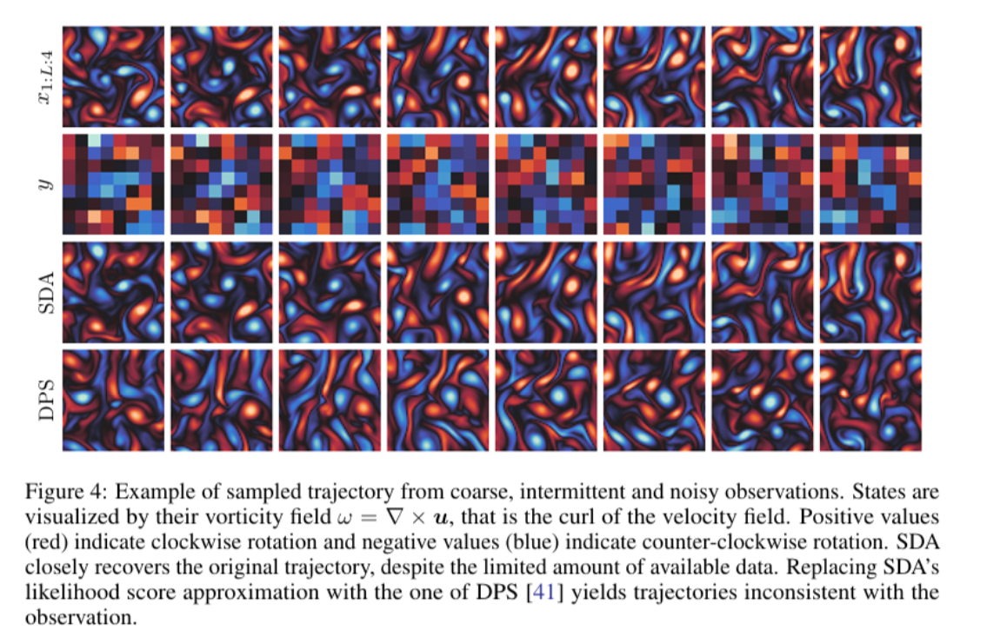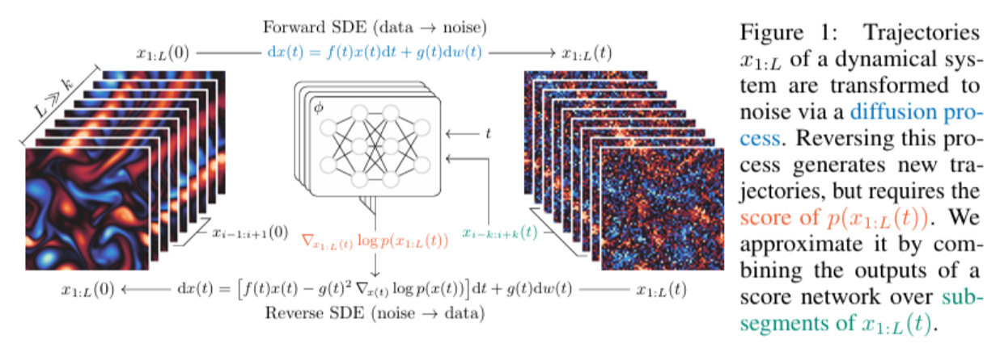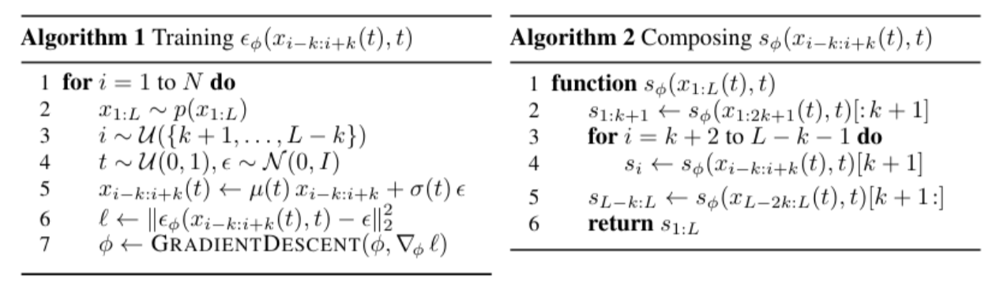